In [1]:
import numpy as np
import pandas as pd
import math
import sklearn
import sklearn.preprocessing
import datetime
import os
import matplotlib.pyplot as plt
import tensorflow as tf

# split data in 80%/10%/10% train/validation/test sets
valid_set_size_percentage = 10 
test_set_size_percentage = 10 

In [2]:
# import all stock prices 
df = pd.read_csv("prices-split-adjusted.csv")
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 851264 entries, 0 to 851263
Data columns (total 7 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   date    851264 non-null  object 
 1   symbol  851264 non-null  object 
 2   open    851264 non-null  float64
 3   close   851264 non-null  float64
 4   low     851264 non-null  float64
 5   high    851264 non-null  float64
 6   volume  851264 non-null  float64
dtypes: float64(5), object(2)
memory usage: 45.5+ MB


In [3]:
df[df.symbol == 'IBM'].head()

,date,symbol,open,close,low,high,volume
470,2010-01-04,IBM,131.179993,132.449997,130.850006,132.970001,6155300.0
938,2010-01-05,IBM,131.679993,130.850006,130.100006,131.850006,6841400.0
1406,2010-01-06,IBM,130.679993,130.000000,129.809998,131.490005,5605300.0
1874,2010-01-07,IBM,129.869995,129.550003,128.910004,130.250000,5840600.0
2342,2010-01-08,IBM,129.070007,130.850006,129.050003,130.919998,4197200.0


In [4]:
import plotly.graph_objects as go

import pandas as pd
from datetime import datetime

fig = go.Figure(data=[go.Candlestick(x=df['date'],
                open=df[df.symbol == 'IBM'].open.values, 
                high=df[df.symbol == 'IBM'].high.values,
                low=df[df.symbol == 'IBM'].low.values, 
                close=df[df.symbol == 'IBM'].close.values)
                ])
fig.update_layout(yaxis_range=[100,160])
fig.show()

In [5]:
fig.show()

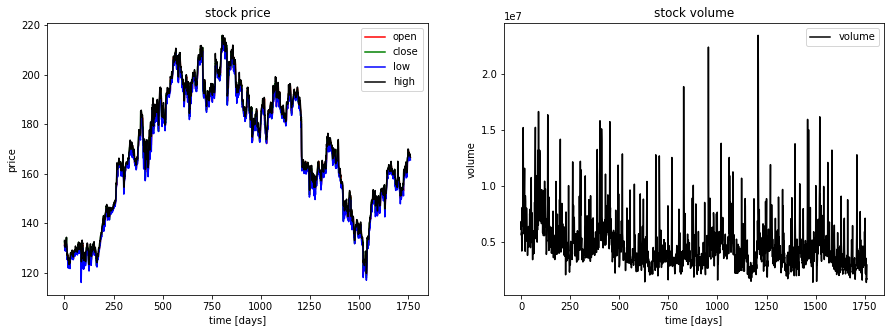

In [6]:
plt.figure(figsize=(15, 5));
plt.subplot(1,2,1);
plt.plot(df[df.symbol == 'IBM'].open.values, color='red', label='open')
plt.plot(df[df.symbol == 'IBM'].close.values, color='green', label='close')
plt.plot(df[df.symbol == 'IBM'].low.values, color='blue', label='low')
plt.plot(df[df.symbol == 'IBM'].high.values, color='black', label='high')
plt.title('stock price')
plt.xlabel('time [days]')
plt.ylabel('price')
plt.legend(loc='best')
#plt.show()

plt.subplot(1,2,2);
plt.plot(df[df.symbol == 'IBM'].volume.values, color='black', label='volume')
plt.title('stock volume')
plt.xlabel('time [days]')
plt.ylabel('volume')
plt.legend(loc='best');

In [9]:
ibm_stock = df[df['symbol'] == 'IBM']

In [11]:
from sklearn.preprocessing import MinMaxScaler

In [12]:
x_scaler = MinMaxScaler()
y_scaler = MinMaxScaler()
ibm_df = ibm_stock.copy()
ibm_df.drop(['symbol'], axis=1, inplace=True)
x = ibm_df[['open', 'low', 'high', 'volume']].copy()
y = ibm_df['close'].copy()

x[['open', 'low', 'high', 'volume']] = x_scaler.fit_transform(x)
y = y_scaler.fit_transform(y.values.reshape(-1, 1))

In [13]:
def load_data(X, seq_len, train_size=0.9):
    amount_of_features = X.shape[1]
    X_mat = X.values
    sequence_length = seq_len + 1
    data = []
    
    for index in range(len(X_mat) - sequence_length):
        data.append(X_mat[index: index + sequence_length])
    
    data = np.array(data)
    train_split = int(round(train_size * data.shape[0]))
    train_data = data[:train_split, :]
    
    x_train = train_data[:, :-1]
    y_train = train_data[:, -1][:,-1]
    
    x_test = data[train_split:, :-1] 
    y_test = data[train_split:, -1][:,-1]

    x_train = np.reshape(x_train, (x_train.shape[0], x_train.shape[1], amount_of_features))
    x_test = np.reshape(x_test, (x_test.shape[0], x_test.shape[1], amount_of_features))  

    return x_train, y_train, x_test, y_test

In [14]:
window = 22
x['close'] = y
X_train, y_train, X_test, y_test = load_data(x, window)
print(X_train.shape, y_train.shape, X_test.shape, y_test.shape)
print (X_train[0], y_train[0])

(1565, 22, 5) (1565,) (174, 22, 5) (174,)
[[0.13124219 0.15106822 0.13830007 0.21607702 0.14905562]
 [0.13640109 0.14343851 0.12666254 0.24723648 0.13272085]
 [0.1260833  0.14048828 0.12292189 0.1910986  0.12404289]
 [0.11772591 0.13133269 0.11003738 0.20178482 0.11944874]
 [0.10947181 0.13275689 0.11699912 0.12714928 0.13272085]
 [0.13000411 0.12889113 0.11845382 0.19678005 0.11873402]
 [0.10905901 0.13224822 0.12125934 0.30355602 0.12924958]
 [0.1230912  0.13387593 0.11907723 0.22970616 0.12639099]
 [0.12474209 0.14150563 0.13559855 0.25951678 0.14762633]
 [0.14001237 0.15350962 0.13746879 0.32230801 0.14221542]
 [0.13588532 0.15829092 0.15160014 0.56854081 0.16630934]
 [0.12381353 0.13173954 0.11938894 0.62673146 0.12659522]
 [0.12391665 0.12268563 0.1146093  0.37290976 0.1138336 ]
 [0.1053446  0.09532048 0.09590603 0.39470911 0.07810109]
 [0.08120102 0.09877923 0.07512464 0.19714792 0.08443088]
 [0.07697068 0.0957274  0.08406065 0.26058404 0.08065341]
 [0.07593892 0.09196338 0.0758

In [15]:
from keras.layers.core import Dense, Activation, Dropout
from keras.layers.recurrent import LSTM
from keras.models import Sequential
from tensorflow.keras import activations
from sklearn.model_selection import  train_test_split

In [33]:
model = Sequential()

model.add(LSTM(400,input_shape=input_shape,return_sequences=True))

model.add(Dropout(0.2))

model.add(LSTM(300,return_sequences=True))

model.add(Dropout(0.2))

model.add(LSTM(200,return_sequences=True))

model.add(Dropout(0.2)) 

model.add(LSTM(100,return_sequences=True))

model.add(Dropout(0.1)) 


#  model.add(Dense(20,activation='relu'))
#  model.add(Dense(10,activation='relu'))
#  model.add(Dense(5,activation='relu'))
model.add(Dense(1))
model.add(Activation('linear'))


model.compile(loss='mse', optimizer='adam')


In [34]:
model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_13 (LSTM)              (None, 22, 400)           649600    
                                                                 
 dropout_12 (Dropout)        (None, 22, 400)           0         
                                                                 
 lstm_14 (LSTM)              (None, 22, 300)           841200    
                                                                 
 dropout_13 (Dropout)        (None, 22, 300)           0         
                                                                 
 lstm_15 (LSTM)              (None, 22, 200)           400800    
                                                                 
 dropout_14 (Dropout)        (None, 22, 200)           0         
                                                                 
 lstm_16 (LSTM)              (None, 22, 100)          

In [39]:
model.fit(
    X_train, 
    y_train,
    batch_size=32,
    epochs=10, verbose=1, validation_split=0.05)

Epoch 1/10
47/47 [==============================] - 41s 858ms/step - loss: 0.0631 - val_loss: 0.1311
Epoch 2/10
47/47 [==============================] - 48s 1s/step - loss: 0.0635 - val_loss: 0.1237
Epoch 3/10
47/47 [==============================] - 36s 750ms/step - loss: 0.0634 - val_loss: 0.1597
Epoch 4/10
47/47 [==============================] - 34s 734ms/step - loss: 0.0629 - val_loss: 0.1460
Epoch 5/10
47/47 [==============================] - 36s 777ms/step - loss: 0.0634 - val_loss: 0.1141
Epoch 6/10
47/47 [==============================] - 34s 725ms/step - loss: 0.0631 - val_loss: 0.0990
Epoch 7/10
47/47 [==============================] - 35s 737ms/step - loss: 0.0632 - val_loss: 0.1478
Epoch 8/10
47/47 [==============================] - 35s 743ms/step - loss: 0.0629 - val_loss: 0.1415
Epoch 9/10
47/47 [==============================] - 34s 729ms/step - loss: 0.0629 - val_loss: 0.1486
Epoch 10/10
47/47 [==============================] - 35s 745ms/step - loss: 0.0629 - val_loss:

In [19]:
input_shape=(window, 5)

In [25]:
modell = Sequential()
d=0.2
modell.add(LSTM(128, input_shape=input_shape, return_sequences=True))
modell.add(Dropout(d))
        
modell.add(LSTM(128, input_shape=input_shape, return_sequences=False))
modell.add(Dropout(d))
        
modell.add(Dense(32,kernel_initializer="uniform",activation='relu'))        
modell.add(Dense(1,kernel_initializer="uniform",activation='linear'))
    
modell.compile(loss='mse',optimizer='adam', metrics=['mse'])


In [26]:
modell.fit(X_train, y_train, batch_size=32, epochs=20, verbose=1, validation_split=0.05)


Epoch 1/20
47/47 [==============================] - 10s 112ms/step - loss: 0.1059 - mse: 0.1059 - val_loss: 0.0589 - val_mse: 0.0589
Epoch 2/20
47/47 [==============================] - 5s 100ms/step - loss: 0.0076 - mse: 0.0076 - val_loss: 0.0072 - val_mse: 0.0072
Epoch 3/20
47/47 [==============================] - 5s 100ms/step - loss: 0.0047 - mse: 0.0047 - val_loss: 0.0063 - val_mse: 0.0063
Epoch 4/20
47/47 [==============================] - 5s 100ms/step - loss: 0.0040 - mse: 0.0040 - val_loss: 0.0055 - val_mse: 0.0055
Epoch 5/20
47/47 [==============================] - 5s 101ms/step - loss: 0.0036 - mse: 0.0036 - val_loss: 0.0043 - val_mse: 0.0043
Epoch 6/20
47/47 [==============================] - 5s 112ms/step - loss: 0.0035 - mse: 0.0035 - val_loss: 0.0042 - val_mse: 0.0042
Epoch 7/20
47/47 [==============================] - 5s 100ms/step - loss: 0.0037 - mse: 0.0037 - val_loss: 0.0032 - val_mse: 0.0032
Epoch 8/20
47/47 [==============================] - 5s 99ms/step - loss: 0.

In [43]:
plot_x = df['date'].copy()

(174, 1)
(174, 1)


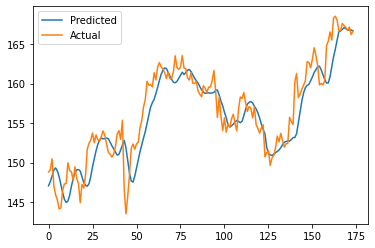

In [44]:
trainPredict = modell.predict(X_train)
testPredict = modell.predict(X_test)
trainPredict = y_scaler.inverse_transform(trainPredict)
trainY = y_scaler.inverse_transform([y_train])
testPredict = y_scaler.inverse_transform(testPredict)
testY = y_scaler.inverse_transform([y_test])
plot_predicted = testPredict.copy()
plot_predicted = plot_predicted.reshape(174, 1)
plot_actual = testY.copy()
plot_actual = plot_actual.reshape(174, 1)
print(plot_actual.shape)
print(plot_predicted.shape)
plot_x = pd.to_datetime(plot_x.iloc[-174:])
plt.plot(pd.DataFrame(plot_predicted), label='Predicted')
plt.plot(pd.DataFrame(plot_actual), label='Actual')
plt.legend(loc='best')
plt.show()